In [1]:
import os
import random
import shutil, os
import pandas as pd

from os import listdir
from os.path import isfile, join

In [2]:
truth_file = pd.read_csv('/Users/sleung2/Documents/MIDS Program/Capstone/snapshot_wisconsin/all/yolo_splits3/test/test_labels.csv')

In [3]:
#Read lines from txt results file

toppath = 'test_results/'
txt_file = 'results-species-call.txt'

with open(toppath + txt_file, 'r') as f:
    original_lines = f.readlines()


In [6]:

rows = []

for item in original_lines:
    
    #Class number
    item_split_1 = item.split(' Bbox[list]')[0]
    class_conf_list = item_split_1.split(';')[1:-2]
    
    conf_score_max = 0
    
    i = 0    
    for class_conf in class_conf_list:
        conf_score_int = float(class_conf.split(',Conf:')[1])
        
        
        if conf_score_int > conf_score_max:
            conf_score_max = conf_score_int
            max_index = i
            
        i += 1
    try:
        class_string = class_conf_list[max_index].split(',')[0]
        class_num = float(class_string.split(':')[1])
        class_num = int(class_num)
    except:
        class_num = 'Blank'

    #Counts
    count_split_1 = item.split(' Bbox[list]')[-1]
    count_split_2 = count_split_1.replace(';', ',')  
    count_split_3 = count_split_2.split(',')
    count = int((len(count_split_3)-1)/4)
        
    #Filename
    file_split_1 = item.split('Filename: ')[1]
    file_name = file_split_1.split(';')[0].split('.jpg')[0]
        
    row = [file_name, class_num, count, conf_score_max]
    
    rows.append(row)       

In [7]:
predictions = pd.DataFrame(rows, columns = ['filename', 'class', 'count', 'conf_score_max'])




Species
1. Events with multiple images of same class will be labeled the majority class
- For event to be labeled Blank, all images must be blank
2. Events with all different labels will get labelled with highest confidence score 

Counts
1. Events with multiple images of same class- we will take the max of the majority class
2. Events with all different labels will get labelled with the count of highest conf score label

In [107]:
#Event column- remove A,B,C appendix
predictions['event'] = predictions['filename'].str[:-1]


## Logic
#Species
# 1. Events with multiple images of same class will be labeled the majority class
#        - For event to be labeled Blank, all images must be blank
# 2. Events with all different labels will get labelled with highest confidence score 
#Counts
# 1. Events with multiple images of same class- we will take the max of the majority class
# 2. Events with all different labels will get labelled with the count of highest conf score label


## Events with muliple images of same class
#Species determination
#Groupby event, class
event_class_group_count = pd.DataFrame(predictions.groupby(['event', 'class']).count()['filename']).reset_index().rename(columns = {'filename': 'count_rows'})

#Filter by rows that have count greater than 1
event_class_group_count_majority = event_class_group_count[event_class_group_count['count_rows'] > 1]

#Remove blank events that are not a consensus for all 3 images
event_class_group_count_majority = event_class_group_count_majority[~((event_class_group_count_majority['class'] == 'Blank') &
                                (event_class_group_count_majority['count_rows'] < 3))]

#Count determination
event_class_group_majority_counts = pd.merge(predictions, event_class_group_count_majority,
         how = 'inner',
         on = ['event', 'class'])

event_class_majority_counts = event_class_group_majority_counts[['event', 'count']].groupby(['event']).max().reset_index()

majority_df = pd.merge(event_class_majority_counts, event_class_group_count_majority,
         on = 'event',
         how = 'left')[['event', 'count','class']]
                                          

In [108]:
#Events with all different labels
predictions_single_count = predictions[~predictions['event'].isin(majority_class_df['event'])]

event_list = []
pred_list = []
count_list = []


previous_event = ''
conf_score_group_max = 0
pred_class = ''

for group_name, group in predictions_single_count_grouped:
        
    current_event = group_name[0]
    current_class = group['class'].iloc[0]
    current_conf_score = group['conf_score_max'].iloc[0]
    current_count = group['count'].iloc[0]
    
    #Check if we are looking at a new event
    if current_event != previous_event:
        conf_score_group_max = 0
        event_list.append(previous_event)
        pred_list.append(pred_class)
        count_list.append(current_count)
    
    if conf_score_group_max < current_conf_score:
        pred_class = current_class
        conf_score_group_max = current_conf_score
        
    previous_event = current_event 

single_class_df = pd.DataFrame(list(zip(event_list[1:],
              pred_list[1:],
              count_list[1:])),
            columns = ['event', 'class', 'count'])

In [113]:
predictions_by_events_df = pd.concat([majority_df, single_class_df])

In [170]:
labels = pd.DataFrame(['foxgray_foxred',
              'cottontail_snowshoehare',
              'raccoon',
              'opossum',
              'turkey',
              'bear',
              'elk',
              'deer',
              'coyote',
              'wolf']).sort_values(0)
labels = labels.rename(columns = {0: 'species'})
labels.insert(0, 'class', range(0, len(labels)))

In [119]:
predictions_by_events_df = pd.merge(predictions_by_events_df, labels,
         how = 'left',
         on = 'class')

In [120]:
truth_pred_df = pd.merge(truth_file, predictions_by_events_df,
                         how = 'left',
                         left_on = 'TRIGGER_ID',
                         right_on = 'event')

In [125]:
truth_pred_df['match'] = truth_pred_df['CLASS_SPECIES_RESTATED'] == truth_pred_df['species']

In [132]:
truth_pred_df.to_excel('truth_pred_df.xlsx')

In [177]:
truth_pred_df_filtered = truth_pred_df[~truth_pred_df['species'].isnull()]
truth_pred_df_filtered = truth_pred_df_filtered[truth_pred_df_filtered['CLASS_SPECIES_RESTATED'] != 'other']



In [229]:
list(pred.unique())


['foxgray_foxred',
 'raccoon',
 'wolf',
 'coyote',
 'cottontail_snowshoehare',
 'deer',
 'elk',
 'bear',
 'opossum',
 'turkey']

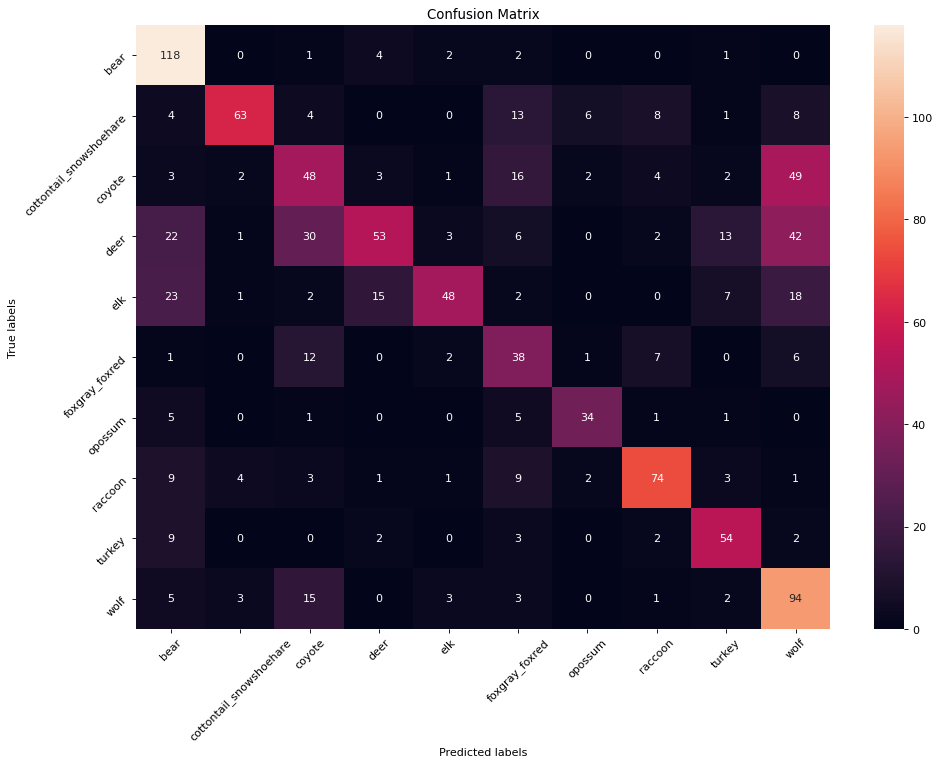

In [232]:
import seaborn as sns
import matplotlib.pyplot as plt   
from sklearn.metrics import confusion_matrix
import pylab as pl
from matplotlib.pyplot import figure

figure(figsize=(14, 10), dpi=80)



y_test= truth_pred_df_filtered['CLASS_SPECIES_RESTATED']
label_list = np.unique(y_test)

pred= truth_pred_df_filtered['species']

cm = confusion_matrix(y_test, pred, labels = label_list)

ax= plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax);  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel(
    'True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(label_list); ax.yaxis.set_ticklabels(label_list);
plt.xticks(rotation = 45)
plt.yticks(rotation = 45)

plt.show()

In [180]:
from sklearn.metrics import classification_report
y_true = truth_pred_df_filtered['CLASS_SPECIES_RESTATED']
y_pred = truth_pred_df_filtered['species']
target_names = label_list
print(classification_report(y_true, y_pred, target_names=target_names))


                         precision    recall  f1-score   support

         foxgray_foxred       0.59      0.92      0.72       128
                raccoon       0.85      0.59      0.70       107
                 coyote       0.41      0.37      0.39       130
                   wolf       0.68      0.31      0.42       172
                   deer       0.80      0.41      0.55       116
                    elk       0.39      0.57      0.46        67
cottontail_snowshoehare       0.76      0.72      0.74        47
                opossum       0.75      0.69      0.72       107
                 turkey       0.64      0.75      0.69        72
                   bear       0.43      0.75      0.54       126

               accuracy                           0.58      1072
              macro avg       0.63      0.61      0.59      1072
           weighted avg       0.63      0.58      0.57      1072



In [214]:
truth_pred_df_filtered_false = truth_pred_df_filtered[truth_pred_df_filtered['match'] == False].sample(frac = 1)

In [221]:
truth_pred_df_filtered_false = truth_pred_df_filtered_false.sort_values(by = ['CLASS_SPECIES_RESTATED', 'event'])

In [222]:
truth_pred_df_filtered_false

,TRIGGER_ID,CLASS_SPECIES,Total,CLASS_SPECIES_RESTATED,event,count,class,species,match
218,SSWI000000014114079,Bear,1,bear,SSWI000000014114079,1.0,5,foxgray_foxred,False
555,SSWI000000018802363,Bear,1,bear,SSWI000000018802363,2.0,5,foxgray_foxred,False
557,SSWI000000018802370,Bear,1,bear,SSWI000000018802370,1.0,8,turkey,False
558,SSWI000000018802382,Bear,1,bear,SSWI000000018802382,1.0,4,elk,False
714,SSWI000000019828089,Bear,1,bear,SSWI000000019828089,1.0,4,elk,False
...,...,...,...,...,...,...,...,...,...
1083,SSWI000000020961807,Wolf,1,wolf,SSWI000000020961807,2.0,1,cottontail_snowshoehare,False
1117,SSWI000000021472127,Wolf,1,wolf,SSWI000000021472127,5.0,4,elk,False
1118,SSWI000000021472129,Wolf,1,wolf,SSWI000000021472129,2.0,4,elk,False
1191,SSWI000000023059055,Wolf,1,wolf,SSWI000000023059055,1.0,1,cottontail_snowshoehare,False


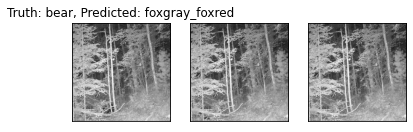

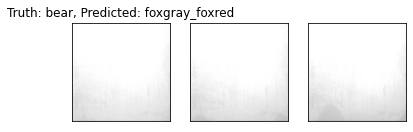

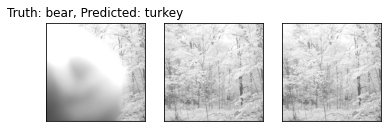

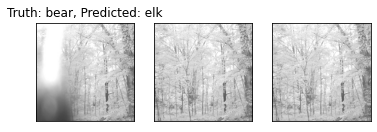

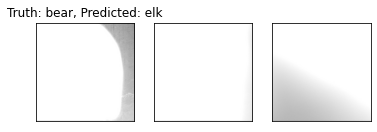

...

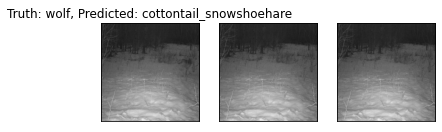

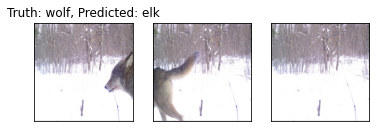

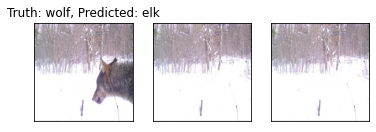

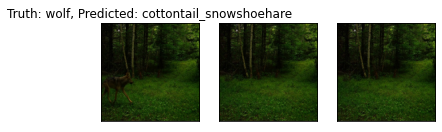

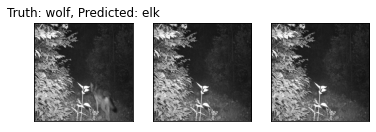

In [224]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import sys
%matplotlib inline

for row,values in truth_pred_df_filtered_false.iterrows():

    event = values['event']
    truth = values['CLASS_SPECIES_RESTATED']
    pred = values['species']
    
    titles = 'Truth: {}, Predicted: {}'.format(truth, pred)
    images = []
    for image_letter in ['A', 'B', 'C']:
        try:
            uncolored_im = cv2.imread('/Users/sleung2/Documents/MIDS Program/Capstone/snapshot_wisconsin/all/yolo_splits3/test/images/{}{}.jpg'.format(event, image_letter),cv2.IMREAD_COLOR)
            im = cv2.cvtColor(uncolored_im, cv2.COLOR_BGR2RGB)


            images.append(im)
        except:
            continue
            
    for i in range(len(images)):
        plt.subplot(1,3,i+1),plt.imshow(images[i])
        if i == 0:
            plt.title(titles)
        plt.xticks([]),plt.yticks([])

    plt.show()
    
#     h,w = im.shape[:2]
#     print(im.shape)
#     plt.imshow(im)
#     plt.show()

In [191]:
for file in os.listdir('/Users/sleung2/Documents/MIDS Program/Capstone/snapshot_wisconsin/all/yolo_splits3/test/images/'):
        print(file)

SSWI000000019581852B.jpg
SSWI000000017053464A.jpg
SSWI000000020365431C.jpg
SSWI000000020143634C.jpg
SSWI000000017771284A.jpg
SSWI000000022210008C.jpg
SSWI000000019326590C.jpg
SSWI000000019521649C.jpg
SSWI000000010298488A.jpg
SSWI000000020301212A.jpg
SSWI000000020365850A.jpg
SSWI000000020366285A.jpg
SSWI000000018605235A.jpg
SSWI000000002741773B.jpg
SSWI000000017908487A.jpg
SSWI000000020162722A.jpg
SSWI000000020504230A.jpg
SSWI000000017387121C.jpg
SSWI000000016701571B.jpg
SSWI000000021129734A.jpg
SSWI000000020153090A.jpg
SSWI000000020297664A.jpg
SSWI000000020162610C.jpg
SSWI000000022889860B.jpg
SSWI000000005534451A.jpg
SSWI000000019521901A.jpg
SSWI000000015749707C.jpg
SSWI000000016173032A.jpg
SSWI000000020078738B.jpg
SSWI000000009759896B.jpg
SSWI000000018992230A.jpg
SSWI000000022139520B.jpg
SSWI000000004770299C.jpg
SSWI000000020300321B.jpg
SSWI000000020301727C.jpg
SSWI000000006487171A.jpg
SSWI000000016457738C.jpg
SSWI000000019779455B.jpg
SSWI000000019697658A.jpg
SSWI000000009432461B.jpg


SSWI000000020162904A.jpg
SSWI000000004395445C.jpg
SSWI000000020162973C.jpg
SSWI000000015074956A.jpg
SSWI000000020163661C.jpg
SSWI000000005067646B.jpg
SSWI000000023514111C.jpg
SSWI000000011042114B.jpg
SSWI000000011724003B.jpg
SSWI000000021668019A.jpg
SSWI000000010853406C.jpg
SSWI000000019325925C.jpg
SSWI000000007936105A.jpg
SSWI000000018313347B.jpg
SSWI000000013839998A.jpg
SSWI000000019828156B.jpg
SSWI000000019327129A.jpg
SSWI000000021475584C.jpg
SSWI000000020280667B.jpg
SSWI000000023145635C.jpg
SSWI000000016525017C.jpg
SSWI000000012047293A.jpg
SSWI000000018802392B.jpg
SSWI000000020302120A.jpg
SSWI000000020473592B.jpg
SSWI000000015327120A.jpg
SSWI000000013550415B.jpg
SSWI000000019046341A.jpg
SSWI000000013550225A.jpg
SSWI000000005534323A.jpg
SSWI000000018237254B.jpg
SSWI000000017062627A.jpg
SSWI000000012325268A.jpg
SSWI000000020301649A.jpg
SSWI000000020163266C.jpg
SSWI000000017267765C.jpg
SSWI000000018060407B.jpg
SSWI000000015207162A.jpg
SSWI000000016874413C.jpg
SSWI000000017236064A.jpg


SSWI000000020467941B.jpg
SSWI000000021273639A.jpg
SSWI000000020364405B.jpg
SSWI000000012766328B.jpg
SSWI000000019306133A.jpg
SSWI000000015443014C.jpg
SSWI000000010724147C.jpg
SSWI000000020506900A.jpg
SSWI000000016424937B.jpg
SSWI000000019326585A.jpg
SSWI000000021187119C.jpg
SSWI000000020398107A.jpg
SSWI000000017053543A.jpg
SSWI000000020365832A.jpg
SSWI000000004560363B.jpg
SSWI000000019157769C.jpg
SSWI000000020163448B.jpg
SSWI000000011696616C.jpg
SSWI000000016952827A.jpg
SSWI000000021296680A.jpg
SSWI000000004068822B.jpg
SSWI000000020666548C.jpg
SSWI000000020364429C.jpg
SSWI000000016918229B.jpg
SSWI000000016760240C.jpg
SSWI000000020297651A.jpg
SSWI000000016452671C.jpg
SSWI000000016172616A.jpg
SSWI000000020301196C.jpg
SSWI000000014844658A.jpg
SSWI000000018651996C.jpg
SSWI000000021871855C.jpg
SSWI000000012863544C.jpg
SSWI000000020301745C.jpg
SSWI000000017341209B.jpg
SSWI000000018283053A.jpg
SSWI000000020300713B.jpg
SSWI000000020301732A.jpg
SSWI000000020908902B.jpg
SSWI000000014743300B.jpg
